# Lab_02 | Image Classification w/ Satellite Imagery | Amber Mine Detector

In 2018, the Ukranian news organization Texty set out to quantify the scale of deforestation and environmental destruction from a surge in illegal mining for amber. Their published investigative project, Leprosy of the Land, trained an image classification machine learning model detect illegal amber mining using satellite imagery.  They then set that model loose on 27,000 square miles of satellite imagery -- 450,000 distinct images -- to quantify the harm from the practice.     

This lab will give you an opportunity to work through a version of their computational processes. You'll run some code, modify some code and evaluate the performance of the machine learning model they built. 

When you see a codeblock, run it! 

Where you see TASK or Task, be sure to follow the instructions. 

There are two extra credit task opportunities, too. 

The major steps are as follows. 

1. Setup
2. Review satellite images that will be used a train a model to detect amber mines.
3. Prepare images for training.
4. Train the model
5. Evaluate the model's performance
6. Turn the model loose on a larger dataset

Note: this lab builds on the truly excellent repo produced by Texty (https://github.com/texty/amber-methodology/blob/master/doc/c+j2019.md). I also benefited from reviewing Jonathan Soma's excellent tutorial on fine-tuning existing models. https://normalai.org/intro/fine-tune-model.html 




## 1. Setup 

### 1a. Create Virtual Environment (Optional)

If you are having problems getting packages installed, or if you are having Python path problems, you might benefit from setting up a virtual environment.  This is a unique python environment that will live in your repo.  You'll install packages in it. If you want help doing this, talk to me. 

Steps:

* Run in terminal: python3 -m venv venv
** It will not return anything in the console, but in your file folder in the left sidebar in VSCode, you should see a greyed-out folder called 'venv'
* Next, run in terminal: source venv/bin/activate
** It will not return anything in the console, but you know you've entered it if your cursor prompt has '(venv)' at the extreme far left.  
*** Before I entered the virtual environment, mine looked like this.
**** (base) smussend@jourwk3100f-01m investigative_reporting_with_AI % 
*** After I entered, it looked like this
**** (venv) (base) smussend@jourwk3100f-01m investigative_reporting_with_AI %


### 1b. Install packages in virtual environment or regular environment

You may need to install some or all of the following packages.  In the terminal, run: 

pip3 install tensorflow pillow matplotlib numpy scikit-image scikit-learn xgboost seaborn joblib ipykernel


### 1c. Load packages

Run this codeblock to load required packages.

In [1]:
# To install the required packages, run:
# pip3 install tensorflow pillow matplotlib numpy scikit-image scikit-learn xgboost seaborn joblib ipykernel

###
# Machine learning libraries
###

# TensorFlow: An open-source platform for machine learning, used here for feature extraction with ResNet
# URL: https://www.tensorflow.org/
import tensorflow as tf
from tensorflow.keras.applications import ResNet50  # Pre-trained ResNet50 model for feature extraction
from tensorflow.keras.preprocessing import image  # Utilities for image preprocessing
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions  # Functions for preprocessing input and decoding predictions

# Scikit-learn: A machine learning library for Python, used here for data preprocessing and evaluation
# URL: https://scikit-learn.org/
from sklearn.model_selection import train_test_split  # For splitting data into training and testing sets
from sklearn.preprocessing import LabelEncoder  # For encoding labels as integers
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, f1_score, recall_score  # For evaluating model performance

# Scikit-image: A collection of algorithms for image processing
# URL: https://scikit-image.org/
from skimage import io  # For reading and writing images
from skimage.segmentation import slic, mark_boundaries  # For segmenting images and marking boundaries
from skimage.util import img_as_float  # For converting images to floating point format
from skimage.measure import regionprops  # For measuring properties of labeled image regions


# XGBoost: An optimized distributed gradient boosting library, used here for building the classification model
# URL: https://xgboost.readthedocs.io/
from xgboost import XGBClassifier
import xgboost as xgb

###
# Data visualization libraries
### 

# Matplotlib: A plotting library for creating static, animated, and interactive visualizations
# URL: https://matplotlib.org/
import matplotlib.pyplot as plt

# Seaborn: A Python visualization library based on matplotlib, used here for statistical data visualization
# URL: https://seaborn.pydata.org/
import seaborn as sns


###
# Other useful stuff
###
# Pandas: A fast, powerful, flexible, and easy-to-use open-source data analysis and data manipulation library
# URL: https://pandas.pydata.org/
import pandas as pd

# NumPy: A fundamental package for scientific computing with Python, used here for handling arrays
# URL: https://numpy.org/
import numpy as np

# PIL (Pillow): Python Imaging Library for opening, manipulating, and saving images
# URL: https://pillow.readthedocs.io/
from PIL import Image

# SciPy: A Python library used for scientific and technical computing
# URL: https://www.scipy.org/
from scipy import misc, ndimage  # For miscellaneous image processing tasks and multi-dimensional image processing

# Joblib: A set of tools to provide lightweight pipelining in Python, used here for saving and loading models
# URL: https://joblib.readthedocs.io/
import joblib

# OS: A module providing a way of using operating system dependent functionality
# URL: https://docs.python.org/3/library/os.html
import os
from os import listdir  # For listing directory contents
from os.path import isfile, join  # For file path manipulations



## 3. Prepare our images for training

Before we can train our model, we need to process our training images a bit to make it easier for our model to learn from them.  We're doing this by extracting key "features" from the images, only the most important bits we'll need to build an accurate model. This process, "feature engineering", is a key part of the machine learning process. 

### 3a. Load a pre-trained model for feature extraction.
Rather than having to do this from scratch, we're going to get some help by passing our images through a pre-trained deep convolutional neural network called ResNet50. ResNet50 is very good at picking out the most important parts of all kinds of images for image classification, in part because it was trained on a labeled dataset of 14 million images (which is a lot). By default, it can identify all or part of an image that contains an object in more than 1,000 categories (animals, vehicles, people, to name a few). With a little extra work, we'll build on it for our task: finding amber mines in images. 

Run the codeblock below to load it. 



In [3]:
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')


Okay, now here's what that same image, represented numerically, looks like after it's passed through ResNet50. 

Run the codeblock below. 

It's a dataframe with 1 row and 2,050 columns. 

There's a column for the image path, and the label assigned to it for training (positive, it contains an amber mine).  

And then there are 2,048 columns that each start with "feature" (feature0 through feature2048). Each numeric value in that column is a bit of information that a very smart model has determined is important for being able to classify an image. Each value is a numeric representative of a pixel pattern identified by ResNet50. 2,048 bits of information to describe an image is A LOT less than 169,425 bits of information, which means faster classification. Only the highest value bits of information remain, meaning less to confuse our model, which should mean higher accuracy. 


### 3e. Use ResNet50 to extract features from our images

Now we'll execute the function to use ResNet50 to extract features from our 1,150 training images, both positive and negative. Run the codeblock below and examine the output, a dataframe similar to what we reviewed above, with one row per image, with a label and 2,048 features identified by ResNet50.

In [ ]:
# where to find positive examples (images with amber extraction footprints ) 
positive_img_path =  "./model/datasets/positive/"  

# Get the list of image files in the positive examples folder
image_files = sorted([f for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))])

# where to find positive examples (images with amber extraction footprints ) 
negative_img_path =  "./model/datasets/negative/"  

# Get the list of image files in the negative examples folder
image_files = sorted([f for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))])

In [10]:
###
# Define function to use ResNet50 to extract information from images
###

def extract_features(img_paths, batch_size=64):
    """ 
    This function extracts image features for each image in img_paths using the ResNet50 penultimate layer.
    Returned features is a numpy array with shape (len(img_paths), 2048).
    """
    global resnet
    n = len(img_paths)  # Number of images in img_paths
    img_array = np.zeros((n, 224, 224, 3))  # Initialize an array to hold the images
    
    for i, path in enumerate(img_paths):
        img = image.load_img(path, target_size=(224, 224))  # Load and resize each image to 224x224
        img = image.img_to_array(img)  # Convert image to array
        img = preprocess_input(img)  # Preprocess the image for ResNet50
        img_array[i] = img  # Add the image to the array
    
    resnet_predictions = resnet.predict(img_array, batch_size=batch_size, verbose=1)  # Extract features using ResNet50
    return resnet_predictions # Return the extracted features

###
# Get a list of training images to process
###

# Define paths to positive and negative image directories
positive_img_path = "./model/datasets/positive/"  # Directory for positive examples (images with amber extraction footprints)
negative_img_path = "./model/datasets/negative/"  # Directory for negative examples

# List all image files in the positive and negative directories
positive_files = [join(positive_img_path, f) for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))]
negative_files = [join(negative_img_path, f) for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))]

# Extract features for positive and negative images
positives_ = extract_features(positive_files)
negatives_ = extract_features(negative_files)

###
# Define function to make a dataframe with ResNet50 results
###

def create_df(feature_vectors, label, img_paths):
    """ 
    Create a pandas DataFrame. Each row in the DataFrame consists of features, label, and path to the corresponding image.
    """
    feat_cols = ['feature' + str(i) for i in range(feature_vectors.shape[1])]  # Column names for elements of feature vector
    df = pd.DataFrame(feature_vectors, columns=feat_cols)  # Create DataFrame with feature vectors
    df['label'] = label  # Add column with labels
    df['path'] = img_paths  # Add column with image paths
    return df

###
# Create the dataframes by running the funcitons
###

# Create DataFrames for positive and negative features
df1 = create_df(positives_, "positive", positive_files)
df2 = create_df(negatives_, "negative", negative_files)

# Concatenate the DataFrames
df = pd.concat([df1, df2], ignore_index=True)
print('Size of the dataframe: {}'.format(df.shape))  # Print the size of the DataFrame

# Save the DataFrame to a CSV file for later use
df.to_csv("features_backup.csv", index=False)

# Display the dataframe
df

4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 884ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 10s 640ms/step
Size of the dataframe: (1150, 2050)


,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,...,feature2040,feature2041,feature2042,feature2043,feature2044,feature2045,feature2046,feature2047,label,path
0,0.669130,0.054925,0.057487,0.088043,1.026728,0.000000,0.000000,0.040677,0.000000,0.019750,...,0.027069,0.102120,0.055177,0.051478,0.000000,3.381316,0.160342,0.076781,positive,./model/datasets/positive/51.5306658_26.461450...
1,0.213282,0.116260,0.120925,0.068036,0.539170,0.041651,0.030687,0.000000,0.342784,0.110229,...,0.232252,0.059773,0.000000,0.236916,0.035513,2.258359,0.002309,0.062593,positive,./model/datasets/positive/51.586462_26.527298_...
2,0.321624,0.220121,0.535129,0.000000,0.199603,0.017902,0.020502,0.002548,0.000000,0.026825,...,0.088960,0.031121,0.000000,0.365371,0.000000,3.131752,0.603472,0.789694,positive,./model/datasets/positive/51.57552510000049_26...
3,0.717783,0.501880,0.416921,0.039752,0.279445,0.057572,0.000000,0.000000,0.217687,0.230528,...,0.026385,0.185315,0.081399,0.192994,0.000000,0.803452,0.896873,0.435465,positive,./model/datasets/positive/51.586382_26.502581_...
4,0.937112,0.160644,0.014463,0.069247,0.459863,0.000000,0.037911,0.000000,0.035145,0.062445,...,0.000000,0.071726,0.000000,0.000000,0.000000,3.713973,0.175259,0.116655,positive,./model/datasets/positive/51.64220910000044_26...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1145,1.425111,0.243341,0.739126,0.028820,0.000856,0.413712,1.096765,0.030851,0.266653,0.000000,...,0.527707,0.236575,0.212238,0.663322,0.154534,4.575552,0.075333,0.525639,negative,./model/datasets/negative/51.457313400000054_2...
1146,1.209502,0.075652,0.076334,0.000053,0.591692,0.020606,2.174306,0.000000,0.782890,0.000000,...,0.069238,0.050972,0.245844,0.357276,0.000000,6.672750,0.048789,0.120591,negative,./model/datasets/negative/51.48732120000003_26...
1147,0.054651,0.151600,1.259222,1.806605,0.176622,0.012041,0.000000,0.000000,0.000000,0.000000,...,0.003869,0.000000,0.000000,0.012449,0.079091,3.717382,0.176185,0.002885,negative,./model/datasets/negative/51.25199320000001_29...
1148,0.221872,0.046702,0.023872,0.001548,0.186226,0.000000,0.048048,0.086120,0.005982,0.000000,...,0.113949,0.107093,0.000000,0.018483,0.000000,2.769068,0.097675,0.000000,negative,./model/datasets/negative/51.49398960000003_26...


## 4. Train the model

So far, we've loaded our training images, used ResNet50 to extract the most important bits for image classification in a more compact format than the raw images, a dataframe with 2,048 features for each image.

Now we'll actually train our model using that dataframe. 

### 4a. Create training set and test set of images

We now split our data into both a "training set" -- which we'll use to train the model -- and the "test set", a different group of images our model has not seen that we'll use to test its performance. 

Run the codeblock below to do that.

In [11]:
###
# Split the Data into Training and Testing Sets
###

# Extract numeric feature values for each image (first 2048 columns)
X = df.iloc[:, 0:2048].values

# Extract labels for each image (2048th column)
Y = df.iloc[:, 2048].values

# Extract paths to image files
tiles = df["path"].values

# Split the data into training and testing sets
# 70% of the data will be used for training, and 30% for testing
# random_state ensures reproducibility of the split
X_train, X_test, Y_train, Y_test, tiles_train, tiles_test = train_test_split(X, Y, tiles, test_size=0.3, random_state=43)

# Encode the labels as integers
# This is necessary for training the machine learning model
label_encoder = LabelEncoder()
Y_train_encoded = label_encoder.fit_transform(Y_train)  # Fit and transform labels for the training set
Y_test_encoded = label_encoder.transform(Y_test)        # Transform labels for the testing set

### 4b. Train our model using XGBoost classifier

Now, we'll use our training data to train our classification model.  

We're using a classifier called XGBoost for this, shown in the codeblock below. XGBoost is a widely used image classification tool that produces good results quickly. 


In [12]:


###
# Define our XGBoost classifier
###

# Initialize the XGBoost classifier with specific hyperparameters and store it as clf for later use.

clf = XGBClassifier(
    learning_rate=0.01,  # Step size shrinkage used to prevent overfitting. Range: [0,1]
    n_estimators=5000,  # Number of gradient boosted trees. Large value can lead to overfitting.
    max_depth=4,  # Maximum depth of a tree. Increasing this value makes the model more complex and more likely to overfit.
    min_child_weight=6,  # Minimum sum of instance weight (hessian) needed in a child. Used to control overfitting.
    gamma=0,  # Minimum loss reduction required to make a further partition on a leaf node. The larger, the more conservative the algorithm will be.
    subsample=0.8,  # Subsample ratio of the training instances. Prevents overfitting by sampling X% of the training data.
    colsample_bytree=0.8,  # Subsample ratio of columns when constructing each tree. Prevents overfitting by sampling X% of the features.
    reg_alpha=0.005,  # L1 regularization term on weights. Increasing this value makes the model more conservative.
    objective='binary:logistic',  # Specifies the learning task and the corresponding learning objective. Here, it's binary classification.
    nthread=7,  # Number of parallel threads used to run XGBoost. Adjust based on your system's capabilities.
    scale_pos_weight=1,  # Balancing of positive and negative weights. Useful for unbalanced classes.
    seed=27  # Random seed for reproducibility.
)

###
# Fit the XGBoost classifier to the training data aka build the model
###

# X_train: Training features
# Y_train_encoded: Encoded training labels
clf.fit(X_train, Y_train_encoded)


# Save the model using XGBoost's Booster class
booster = clf.get_booster()
booster.save_model('model/versions/xgb_model.json')


### 4c. TASK (extra credit): Explain XGBoost

You don't always have to know how a specific classification function like XGBoost works to use it.  But it can be fun to learn what's going on under the hood. 

Task: Extra credit. Through a combo of web research, engagement with CoPilot or other language model or some other research method, explain how key parts of the XGBoost method works.  To get credit, you must provide an analogy or analogies to some other process (see six-year-old analogy above) that has real explanatory power.  Some key terms you might seek to understand that are part of XGBoost: "gradient descent", "boosting", and "sequential learning."   



## 5. Evaluate the model

Now that we've trained our model, it's time to evaluate its performance.  We will:

* Review a "confusion matrix" to get an overview of perfomrance. 
* Review some assessment metrics: precision, recall, accuracy, fscore.
* Look closely at images it classified correctly and incorrectly.


Run the codeblock below and review the output.

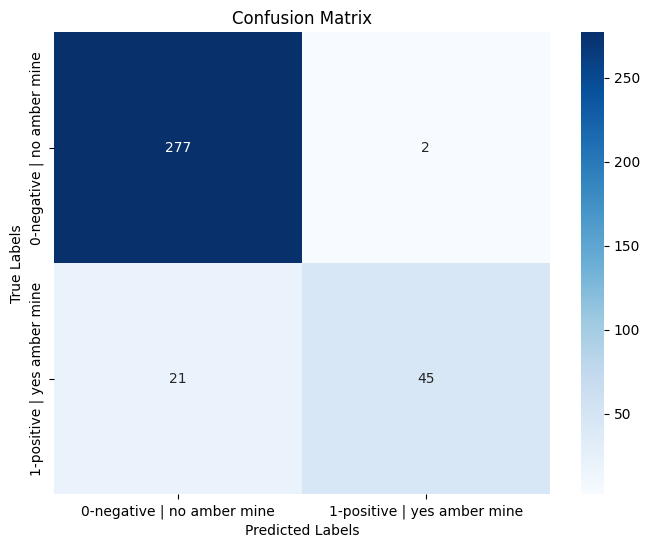

MODEL METRICS
_________
Precision: 0.9574
Recall: 0.6818
F1-Score: 0.7965
Accuracy: 0.9333


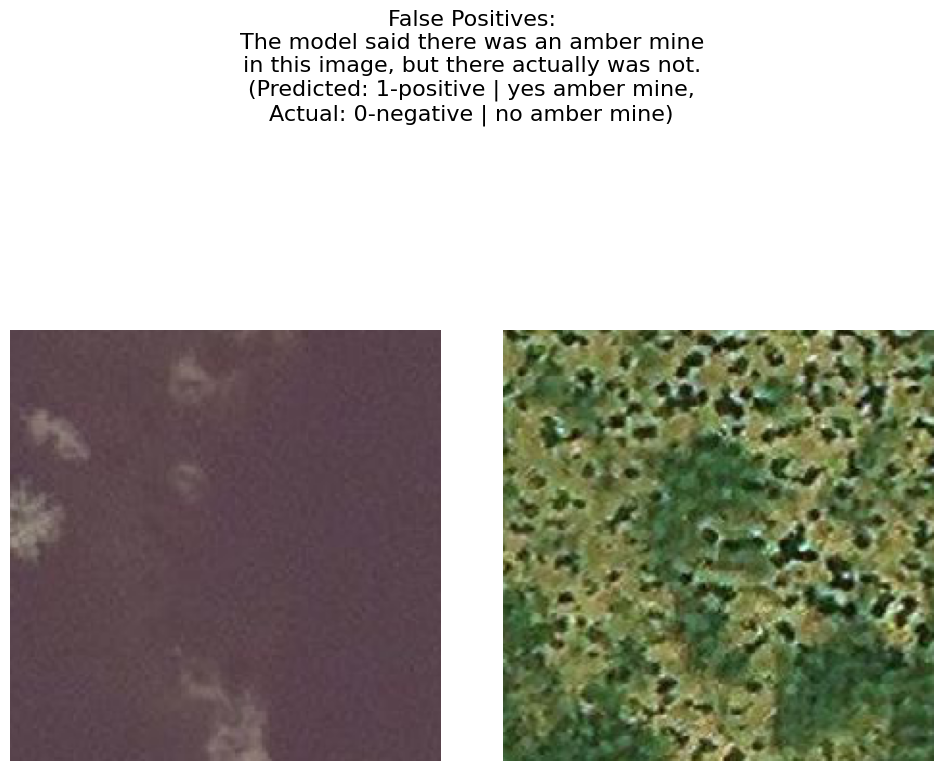

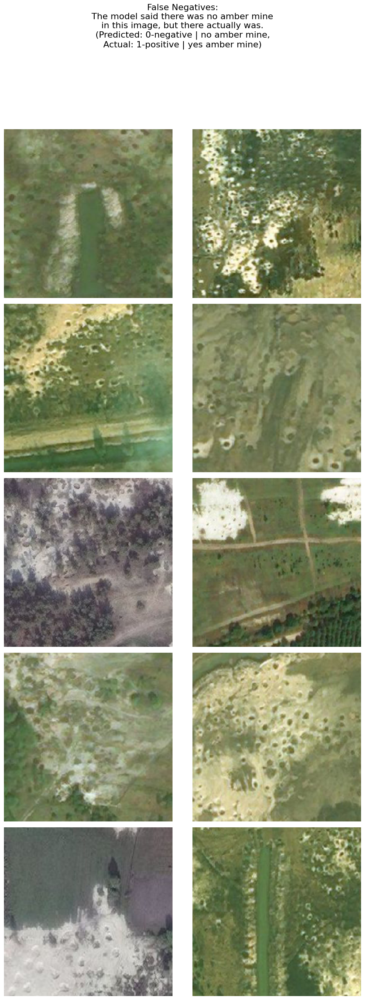

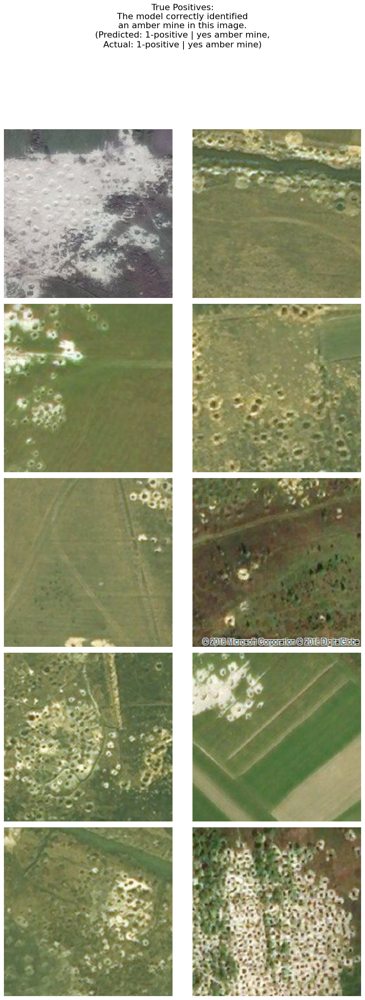

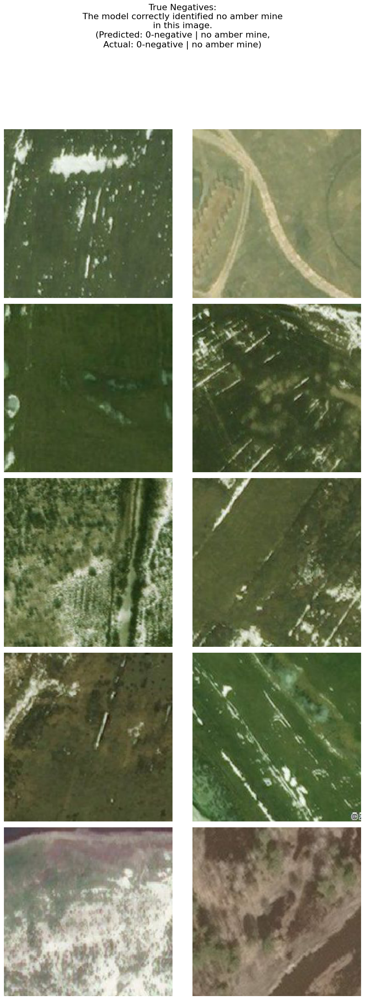

In [13]:
###
# Function to output evaluation information
###

def evaluate(y_true, y_pred, image_paths):

    ###
    # Output a confusion matrix
    ###

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    
    # Create a heatmap for the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['0-negative | no amber mine', '1-positive | yes amber mine'], 
                yticklabels=['0-negative | no amber mine', '1-positive | yes amber mine'])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()
    
    ###
    # Output statistics
    ###

    # Print precision, recall, F1-score, and accuracy

    # Calculate the precision of the predictions
    # Precision is the ratio of correctly predicted positive observations to the total predicted positives
    # It is a measure of the accuracy of the positive predictions
    precision = precision_score(y_true, y_pred, pos_label=1)

    # Calculate the recall of the predictions
    # Recall is the ratio of correctly predicted positive observations to all observations in the actual class
    # It is a measure of the ability of the model to find all the relevant cases within a dataset
    recall = recall_score(y_true, y_pred, pos_label=1)

    # Calculate the F1 score of the predictions
    # F1 score is the weighted average of Precision and Recall
    # It is useful when you need a balance between Precision and Recall
    f1 = f1_score(y_true, y_pred, pos_label=1)

    # Calculate the accuracy of the predictions
    # Accuracy is the ratio of correctly predicted observations to the total observations
    # It is the most intuitive performance measure and it is simply a ratio of correctly predicted observation to the total observations
    accuracy = accuracy_score(y_true, y_pred)
    
    # OPrint values

    print(f"MODEL METRICS")
    print(f"_________")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    
    ###
    # Output examples of correct and incorrect predicions
    ###

    # Identify the indices of false positives, false negatives, true positives, and true negatives
    false_positives = np.where((y_pred == 1) & (y_true == 0))[0]
    false_negatives = np.where((y_pred == 0) & (y_true == 1))[0]
    true_positives = np.where((y_pred == 1) & (y_true == 1))[0]
    true_negatives = np.where((y_pred == 0) & (y_true == 0))[0]
    
    # Extract image paths for each category
    fp_images = image_paths[false_positives]
    fn_images = image_paths[false_negatives]
    tp_images = image_paths[true_positives]
    tn_images = image_paths[true_negatives]
    
    # Display image grids with updated headings for each category
    display_image_grid(
        fp_images, 
        'False Positives:\nThe model said there was an amber mine\nin this image, but there actually was not.\n(Predicted: 1-positive | yes amber mine,\nActual: 0-negative | no amber mine)'
    )
    display_image_grid(
        fn_images, 
        'False Negatives:\nThe model said there was no amber mine\nin this image, but there actually was.\n(Predicted: 0-negative | no amber mine,\nActual: 1-positive | yes amber mine)'
    )
    display_image_grid(
        tp_images, 
        'True Positives:\nThe model correctly identified\nan amber mine in this image.\n(Predicted: 1-positive | yes amber mine,\nActual: 1-positive | yes amber mine)'
    )
    display_image_grid(
        tn_images, 
        'True Negatives:\nThe model correctly identified no amber mine\nin this image.\n(Predicted: 0-negative | no amber mine,\nActual: 0-negative | no amber mine)'
    )

###
# Function to display image grid
###

def display_image_grid(image_paths, title, num_images=10):
    """Display a grid of images from a list of image paths in a 2-column layout."""
    num_rows = (num_images + 1) // 2  # Calculate the number of rows needed for 2 columns
    plt.figure(figsize=(10, num_rows * 5))  # Adjust the figure size based on rows

    for i, img_path in enumerate(image_paths[:num_images]):
        img = image.load_img(img_path, target_size=(224, 224))  # Load image
        plt.subplot(num_rows, 2, i + 1)  # Arrange in a 2-column grid
        plt.imshow(img)
        plt.axis('off')  # Hide axes for a cleaner display

    # Ensure enough space between title and images
    plt.suptitle(title, fontsize=16, ha='center', va='top', y=1.02)  # Move the title higher
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to prevent overlap
    plt.show()

###
# Run evaluation function
###

# Make predictions on the test set
Y_pred = clf.predict(X_test)

# Evaluate the model and display the image grids with updated titles and proper spacing
evaluate(Y_test_encoded, Y_pred, tiles_test)


## 5a. Task: how did it do?

TASK: Write 200 words explaining model performance, based on the output you just reviewed.

Key questions: How did it perform overall? When it failed, in which direction did it fail?  Was it more likely to say an image contained an amber mine when it actually didn't, or was it more likely to say an image did not contain an amber mine when it actually did? After reviewing the images in each classification group, why do you think it hard time accurately capturing some of the images it got wrong?  




## 6. Turn the model loose on a larger dataset
Now that we've got a decent model, we can turn it loose on identifying amber mines in a much larger dataset of map tiles. Recall that each image in our training set was a slice of a larger map tile. We can use our model to identify not just which map tiles contain amber mines, but pippoint specific sections of those tiles that do.  

The reporters on this story looped over a list of map tiles for all of Ukraine to identify and then quantify the scale of illegal mining.  We're just going to try it on a few examples.

The output shows the results of running six map tiles -- three with amber mines and three without -- through our model.  The output displays four different looks at each tile:

* The origial map tile, sliced into about yellow grid with about 30 segments (upper left image).
* Using the model, calculates the probability that a given slice contains an amber mine from 0-100%. If the value is over 70 percent, it turns the label green.  If it's under 70, it's displayed as red (upper right image).
* Highlights the high probability segments (lower left image) and covers up the low probability segments with a grey mask (lower right image).

Run the codeblock below and review the output.

Number of segments: 29
Number of labels: 29


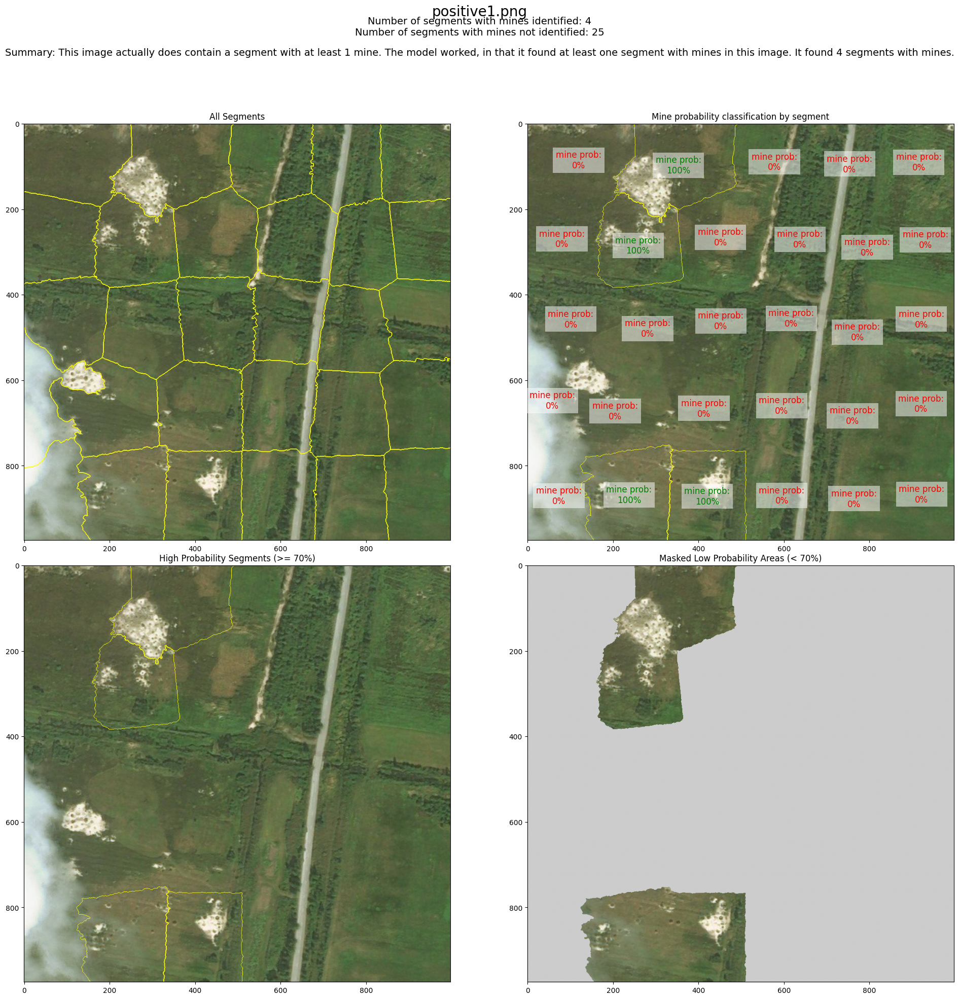

Number of segments: 30
Number of labels: 30


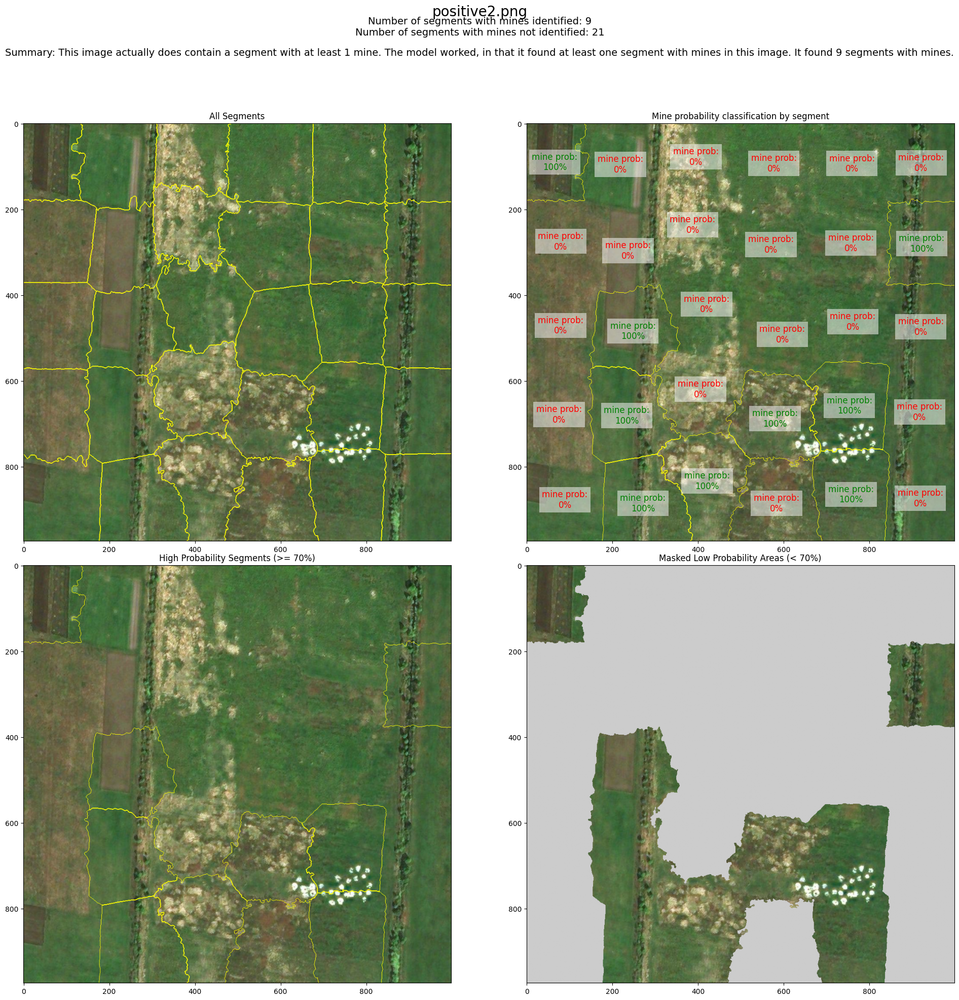

Number of segments: 29
Number of labels: 29


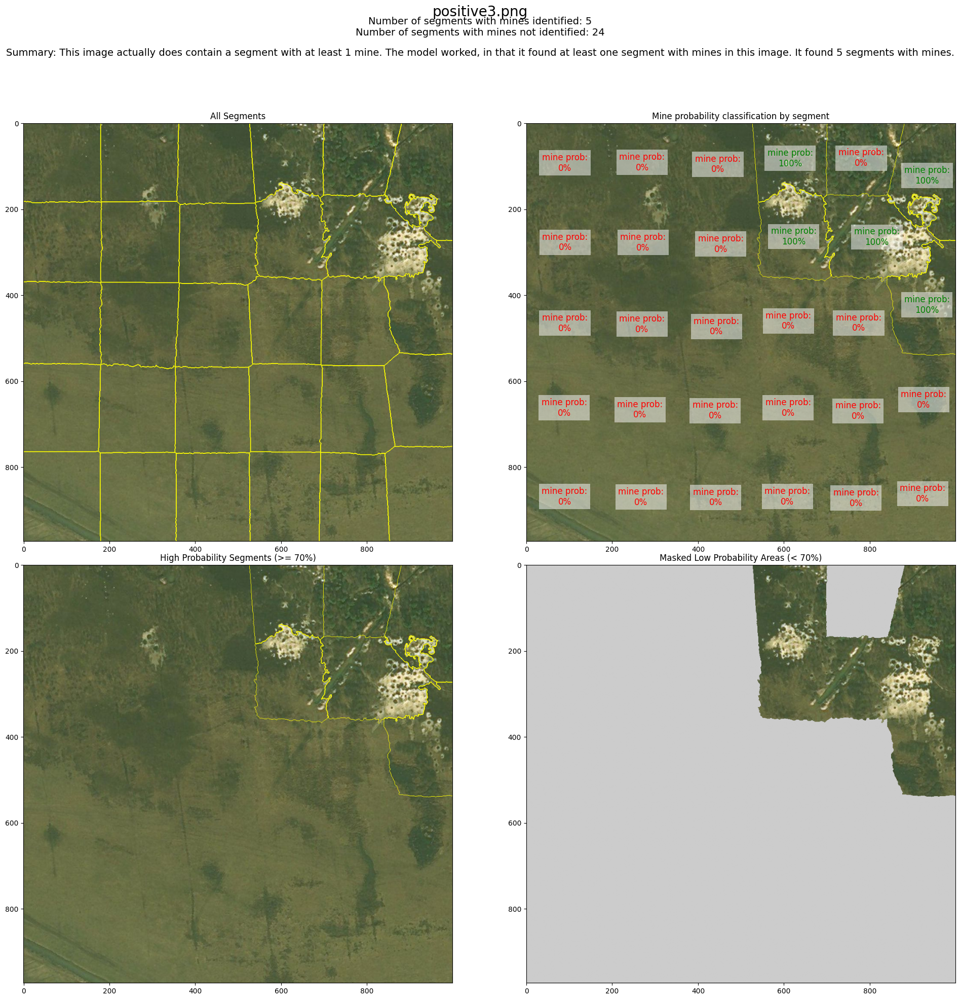

Number of segments: 30
Number of labels: 30


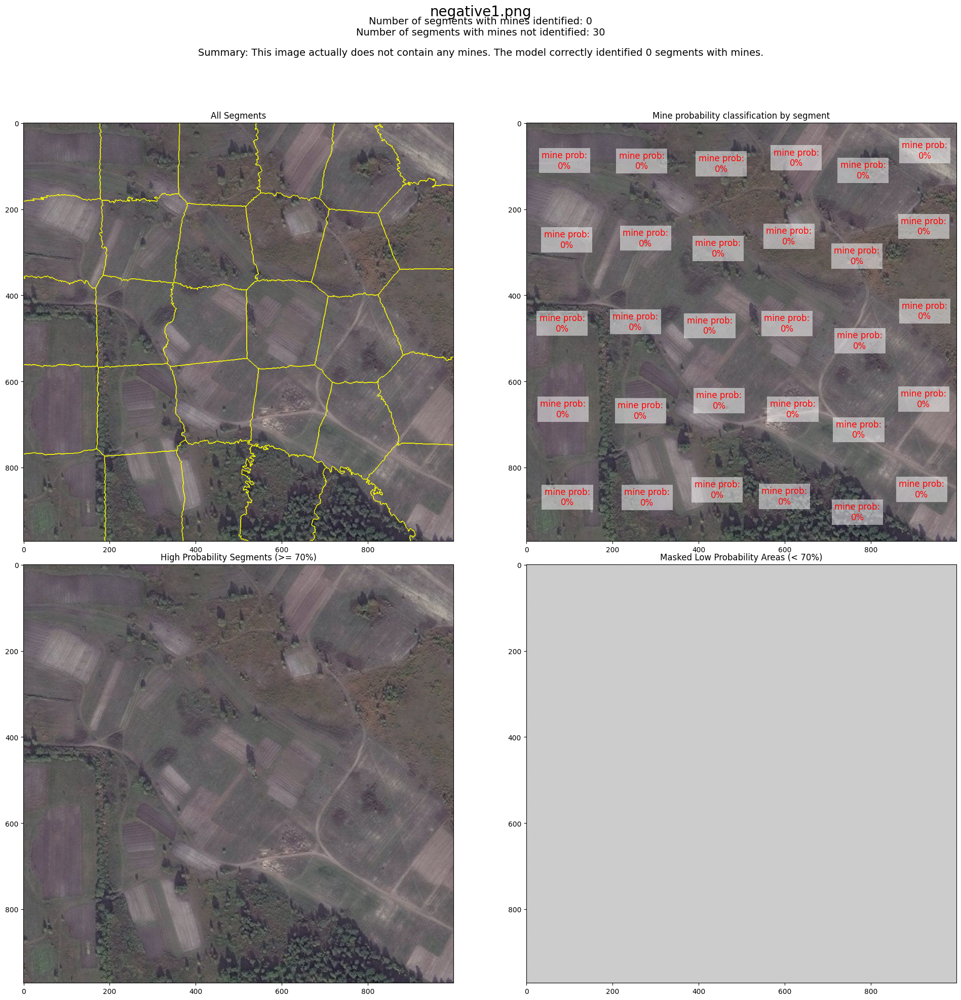

Number of segments: 30
Number of labels: 30


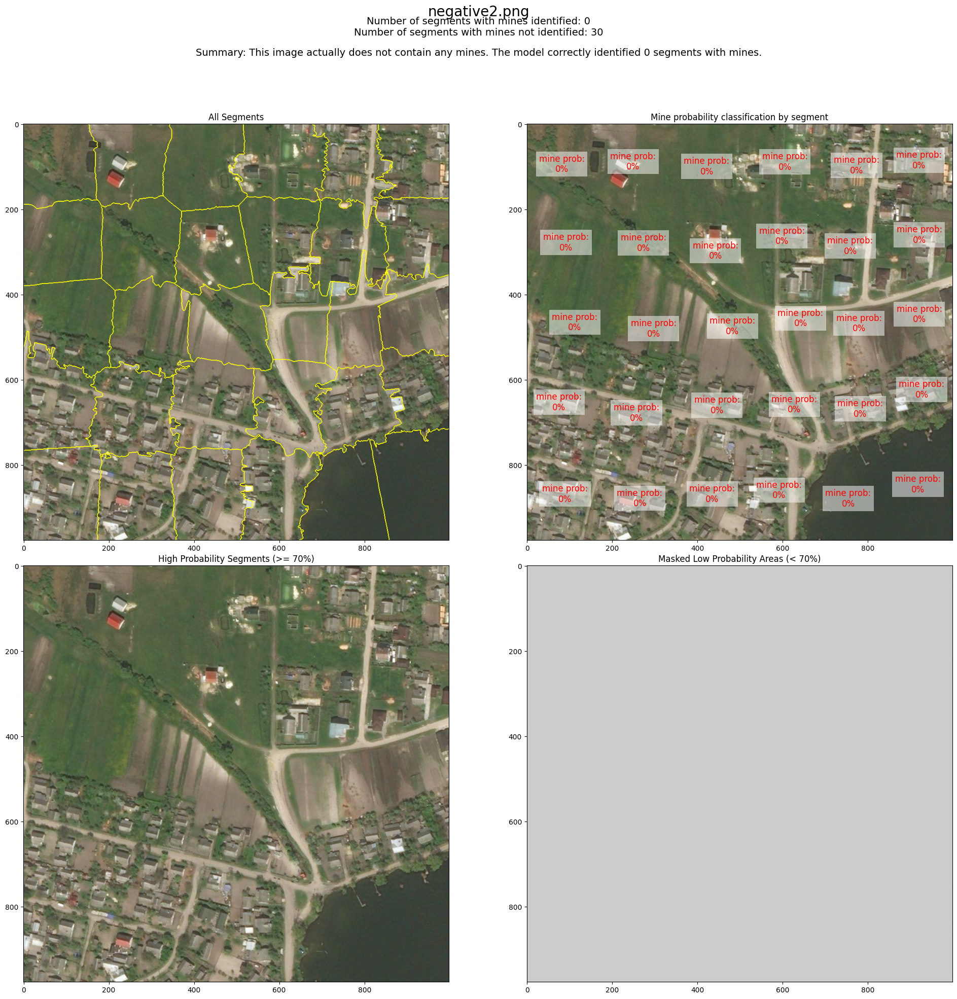

Number of segments: 30
Number of labels: 30


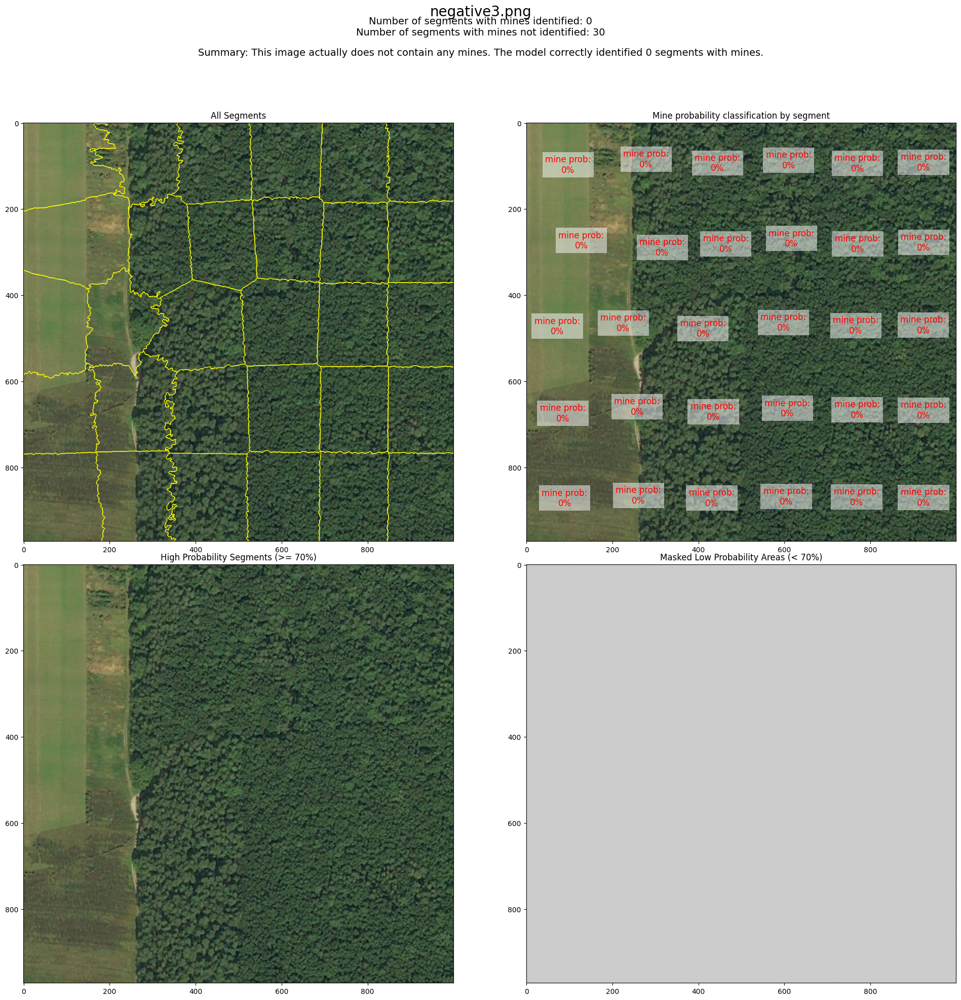

In [14]:

###
# Define Helper Functions to Process Image
###


# Function to create segments from each example tile image @name
def slic_segments(name):
    img = img_as_float(io.imread(name))
    return slic(img, n_segments=30, compactness=35, sigma=1)

# Function to prepare each segment for classification
def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
    width_height_tuple = (target_size[1], target_size[0])
    y0, x0, y1, x1 = segment_info.bbox
    segment_size = (y1 - y0, x1 - x0)
    
    cropped = parent_image_object.crop((x0, y0, x1, y1))
        
    if segment_size != width_height_tuple:
        resample = Image.NEAREST
        cropped = cropped.resize(width_height_tuple, resample)
        
    return cropped

# Function to extract features for each segment/superpixel from image, using Resnet
def features_from_tile(img_name, resnet, batch_size=64):
    segments = [] 
    # Get geometry info about each segment
    segments_info = regionprops(slic_segments(img_name))      
    image_object = Image.open(img_name)
    
    n = len(segments_info)
    img_array = np.zeros((n, 224, 224, 3))
    
    for i, s in enumerate(segments_info):
        img = prepare_segment(s, image_object)
        img = image.img_to_array(img)
        img = preprocess_input(img)
        img_array[i] = img
    
    # Predict features using ResNet
    X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
    return X

# Split to segments, get features, classify segment, return labels for each segment        
def search_in_tile(img_name, classifier, resnet, occurences_treshold=0):
    features = features_from_tile(img_name, resnet)
    features_array = np.array(features)  # Convert features to NumPy array

    #dmatrix_features = xgb.DMatrix(features)  # Convert features to DMatrix
    #Y_pred = classifier.predict(dmatrix_features)
    Y_pred = classifier.predict(features_array)
    labels = Y_pred.tolist()
    
    if labels.count("positive") > occurences_treshold:
        print("amber detected!")
    return labels

# Load ResNet model (takes some time)
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# Example usage
img_name = "./model/datasets/example/positive3.png"
labels = search_in_tile(img_name, clf, resnet)

# Define the folder path
folder_path = "./model/datasets/example"

# List of files
file_list = [
    "positive1.png",
    "positive2.png",
    "positive3.png",
    "negative1.png",
    "negative2.png",
    "negative3.png"
]

# Prepend the folder path to each file name
file_list = [os.path.join(folder_path, file) for file in file_list]



# Function to process each image
def process_image(img_name, clf, resnet):
    # Construct labels using search_in_tile
    labels = search_in_tile(img_name, clf, resnet)

    # Read and preprocess the image
    img = io.imread(img_name)  # image as numpy array
    original_image = Image.fromarray(img.astype('uint8'), 'RGB')  # same image as PIL object
    img = img_as_float(img)  # convert to float, to use for segmentation purposes

    # Split image into segments
    segments_slic = slic(img, n_segments=30, compactness=35, sigma=1)  # split image to segments
    marked_img_all = mark_boundaries(img, segments_slic)  # image with all segments and boundaries

    # Find label values for each segment without amber
    negative_labels = [i + 1 for i, l in enumerate(labels) if l == 0]  # assuming 0 is negative

    # Create a copy of segments_slic for positive segments
    segments_slic_positive = segments_slic.copy()

    # Filter out from our mask all pixels with values for "negative" segments
    segments_slic_positive[np.isin(segments_slic_positive, negative_labels)] = 0

    # Mark boundaries for positive segments
    marked_img_positive = mark_boundaries(img, segments_slic_positive)  # new image has only boundaries for positive segments

    # Show images in a 2x2 grid
    fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))
    filename = os.path.basename(img_name)
    fig.suptitle(f"{filename}", fontsize=20)  # Add the image name as a title above the plots

    ax0.imshow(marked_img_all)
    ax0.set_title("All Segments")
    ax1.imshow(marked_img_positive)
    ax1.set_title("Mine probability classification by segment")

    # Debugging information
    segments_info = regionprops(segments_slic)
    print(f"Number of segments: {len(segments_info)}")
    print(f"Number of labels: {len(labels)}")

    # Ensure the number of labels matches the number of segments
    if len(labels) < len(segments_info):
        labels.extend([-1] * (len(segments_info) - len(labels)))  # Add placeholder labels for missing segments

    # Create a mask for segments with mine probability >= 70%
    segments_slic_high_prob = segments_slic.copy()
    high_prob_count = 0
    low_prob_count = 0
    for i, segment in enumerate(segments_info):
        label = labels[i]
        centroid = segment.centroid
        # Multiply by 100, round to 1 decimal place, and add percentage and text
        percentage = round(label * 100, 1)
        label_text = f"mine prob:\n{percentage}%"
        # Set color based on percentage
        color = 'green' if percentage >= 70 else 'red'
        ax1.text(centroid[1], centroid[0], label_text, color=color, fontsize=12, ha='center', va='center', bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        # Filter out segments with probability < 70%
        if percentage >= 70:
            high_prob_count += 1
        else:
            low_prob_count += 1
            segments_slic_high_prob[segments_slic == (i + 1)] = 0

    # Mark boundaries for high probability segments
    marked_img_high_prob = mark_boundaries(img, segments_slic_high_prob)
    ax2.imshow(marked_img_high_prob)
    ax2.set_title("High Probability Segments (>= 70%)")

    # Mask areas below 70% with solid light grey
    masked_img = img.copy()
    masked_img[segments_slic_high_prob == 0] = [0.8, 0.8, 0.8]  # light grey color
    ax3.imshow(masked_img)
    ax3.set_title("Masked Low Probability Areas (< 70%)")

    # Add subheading with counts
    fig.text(0.5, 0.95, f"Number of segments with mines identified: {high_prob_count}\nNumber of segments with mines not identified: {low_prob_count}", ha='center', fontsize=14)

    # Add summary based on filename
    if "negative" in filename.lower():
        if high_prob_count == 0:
            summary = "This image actually does not contain any mines. The model correctly identified 0 segments with mines."
        else:
            summary = f"This image actually does not contain any mines. The model incorrectly identified {high_prob_count} segments with mines."
    elif "positive" in filename.lower():
        if high_prob_count > 0:
            summary = f"This image actually does contain a segment with at least 1 mine. The model worked, in that it found at least one segment with mines in this image. It found {high_prob_count} segments with mines."
        else:
            summary = "This image actually does contain a segment with at least 1 mine. The model incorrectly predicted that there are no segments with mines in this picture."
    else:
        summary = ""

    fig.text(0.5, 0.93, f"Summary: {summary}", ha='center', fontsize=14)

    fig.tight_layout(rect=[0, 0, 1, 0.90])  # Adjust layout to make room for the title and subheading
    plt.show()

# Loop through the file_list and process each image
for file in file_list:
    process_image(file, clf, resnet)